# Stock X Sneaker Price Anlysis 
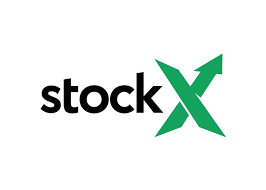

Description: This dataset consists of a random sample of all Off-White x Nike and Yeezy 350 sales from between 9/1/2017 (the month that Off-White first debuted “The Ten” collection) and the present. There are 99,956 total sales in the data set; 27,794 Off-White sales, and 72,162 Yeezy sales. The sample consists of U.S. sales only. (Retrive from: StockX)

Goal: Analyzing the StockX dataset and create visualizations on essential variables that affect the sneaker selling price/ profit. Furthermore, prove existing business strategy for future reference. 

Fact: In general, fewer stock items would sell for more price, which would mean small/large size, no future restock items and more hyped items.

https://stockx.com/sneakers


Grade 270/300
Assembling the dataset: 50/60 points
Cleaning and organizing the dataset: 55/60 points
Exploratory analysis of the dataset: 55/60 points)
Visualizing the dataset: 55/60 points)
Synthesis and Analysis of the dataset: 55/60 points

In [44]:
import pandas as pd
pd.set_option('display.max_rows', None, 'display.max_columns', None)
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as plticker
import seaborn as sns
%matplotlib inline
sns.set(style="ticks", color_codes=True)
plt.rcParams['figure.figsize'] = (8,5)
plt.rcParams['figure.dpi'] = 150

In [45]:
df = pd.read_csv('StockX_Data.csv')
df.head()

,Order Date,Brand,Sneaker Name,Sale Price,Retail Price,Release Date,Shoe Size,Buyer Region
0,9/1/17,Yeezy,Adidas-Yeezy-Boost-350-Low-V2-Beluga,"$1,097",$220,9/24/16,11.0,California
1,9/1/17,Yeezy,Adidas-Yeezy-Boost-350-V2-Core-Black-Copper,$685,$220,11/23/16,11.0,California
2,9/1/17,Yeezy,Adidas-Yeezy-Boost-350-V2-Core-Black-Green,$690,$220,11/23/16,11.0,California
3,9/1/17,Yeezy,Adidas-Yeezy-Boost-350-V2-Core-Black-Red,"$1,075",$220,11/23/16,11.5,Kentucky
4,9/1/17,Yeezy,Adidas-Yeezy-Boost-350-V2-Core-Black-Red-2017,$828,$220,2/11/17,11.0,Rhode Island


In [46]:
#Dataframe Info/Check null

df.info()

df.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99956 entries, 0 to 99955
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Order Date    99956 non-null  object 
 1   Brand         99956 non-null  object 
 2   Sneaker Name  99956 non-null  object 
 3   Sale Price    99956 non-null  object 
 4   Retail Price  99956 non-null  object 
 5   Release Date  99956 non-null  object 
 6   Shoe Size     99956 non-null  float64
 7   Buyer Region  99956 non-null  object 
dtypes: float64(1), object(7)
memory usage: 6.1+ MB


Order Date      0
Brand           0
Sneaker Name    0
Sale Price      0
Retail Price    0
Release Date    0
Shoe Size       0
Buyer Region    0
dtype: int64

# Data Cleaning

In [47]:
# Remove - in sneaker name 
df['Sneaker Name'] = df['Sneaker Name'].apply(lambda x: x.replace('-', ' '))

In [48]:
#adjust data types
#Release Date and Order Date -> datetime
#Retail and Sale prices -> float
sp = [float(x[1:].replace(',', '')) for x in list(df['Sale Price'])]
df['Sale Price'] = sp
rp = [float(x[1:].replace(',', '')) for x in list(df['Retail Price'])]
df['Retail Price'] = rp
df['Release Date'] = pd.to_datetime(df['Release Date'])
df['Order Date'] = pd.to_datetime(df['Order Date'])

In [49]:
#Create two additional columns: Time Released, and Profit
df['Time Released'] = ((df['Order Date'] - df['Release Date'])/ np.timedelta64(1, 'M')).astype(int)
df['Profit'] = (df['Sale Price'] - df['Retail Price'])
df.head()

,Order Date,Brand,Sneaker Name,Sale Price,Retail Price,Release Date,Shoe Size,Buyer Region,Time Released,Profit
0,2017-09-01,Yeezy,Adidas Yeezy Boost 350 Low V2 Beluga,1097.0,220.0,2016-09-24,11.0,California,11,877.0
1,2017-09-01,Yeezy,Adidas Yeezy Boost 350 V2 Core Black Copper,685.0,220.0,2016-11-23,11.0,California,9,465.0
2,2017-09-01,Yeezy,Adidas Yeezy Boost 350 V2 Core Black Green,690.0,220.0,2016-11-23,11.0,California,9,470.0
3,2017-09-01,Yeezy,Adidas Yeezy Boost 350 V2 Core Black Red,1075.0,220.0,2016-11-23,11.5,Kentucky,9,855.0
4,2017-09-01,Yeezy,Adidas Yeezy Boost 350 V2 Core Black Red 2017,828.0,220.0,2017-02-11,11.0,Rhode Island,6,608.0


In [50]:
df.describe()

,Sale Price,Retail Price,Shoe Size,Time Released,Profit
count,99956.000000,99956.00000,99956.000000,99956.000000,99956.000000
mean,446.634719,208.61359,9.344181,5.643243,238.021129
std,255.982969,25.20001,2.329588,7.537915,266.133179
min,186.000000,130.00000,3.500000,-2.000000,-34.000000
25%,275.000000,220.00000,8.000000,0.000000,58.000000
50%,370.000000,220.00000,9.500000,1.000000,154.000000
75%,540.000000,220.00000,11.000000,11.000000,342.000000
max,4050.000000,250.00000,17.000000,43.000000,3860.000000


# Correlation

In [51]:
#Correlation 
corr = df.corr(method = 'kendall')
corr

,Sale Price,Retail Price,Shoe Size,Time Released,Profit
Sale Price,1.000000,-0.297493,0.056163,-0.085795,0.961952
Retail Price,-0.297493,1.000000,-0.042426,0.178149,-0.353989
Shoe Size,0.056163,-0.042426,1.000000,0.011368,0.057596
Time Released,-0.085795,0.178149,0.011368,1.000000,-0.099283
Profit,0.961952,-0.353989,0.057596,-0.099283,1.000000


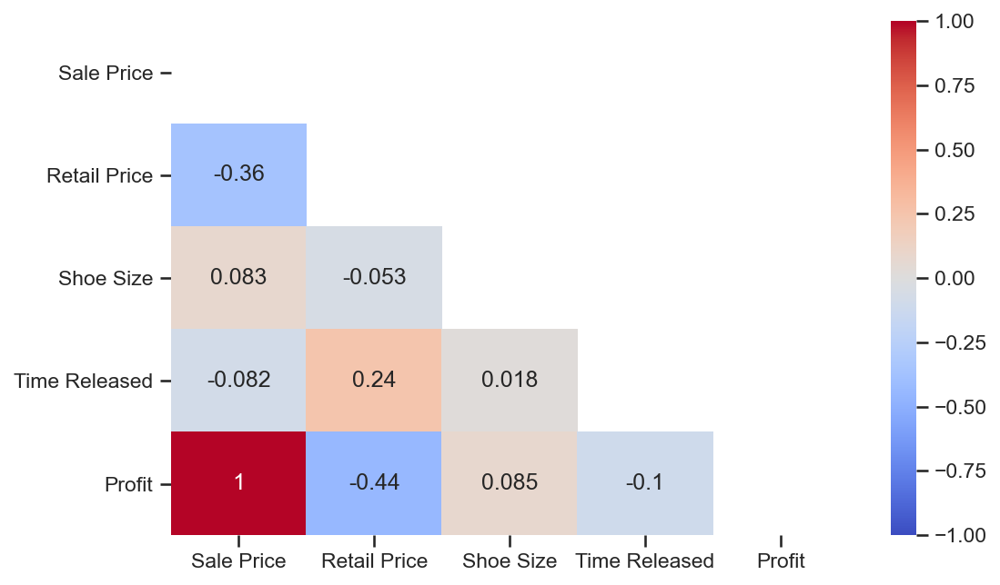

In [52]:
# show heat map of the correlation
upp_mat = np.triu(df.corr())
sns.heatmap(df.corr(), vmin=-1,vmax=+1, annot=True, cmap='coolwarm', mask = upp_mat)
plt.show()

# Data Visualizations

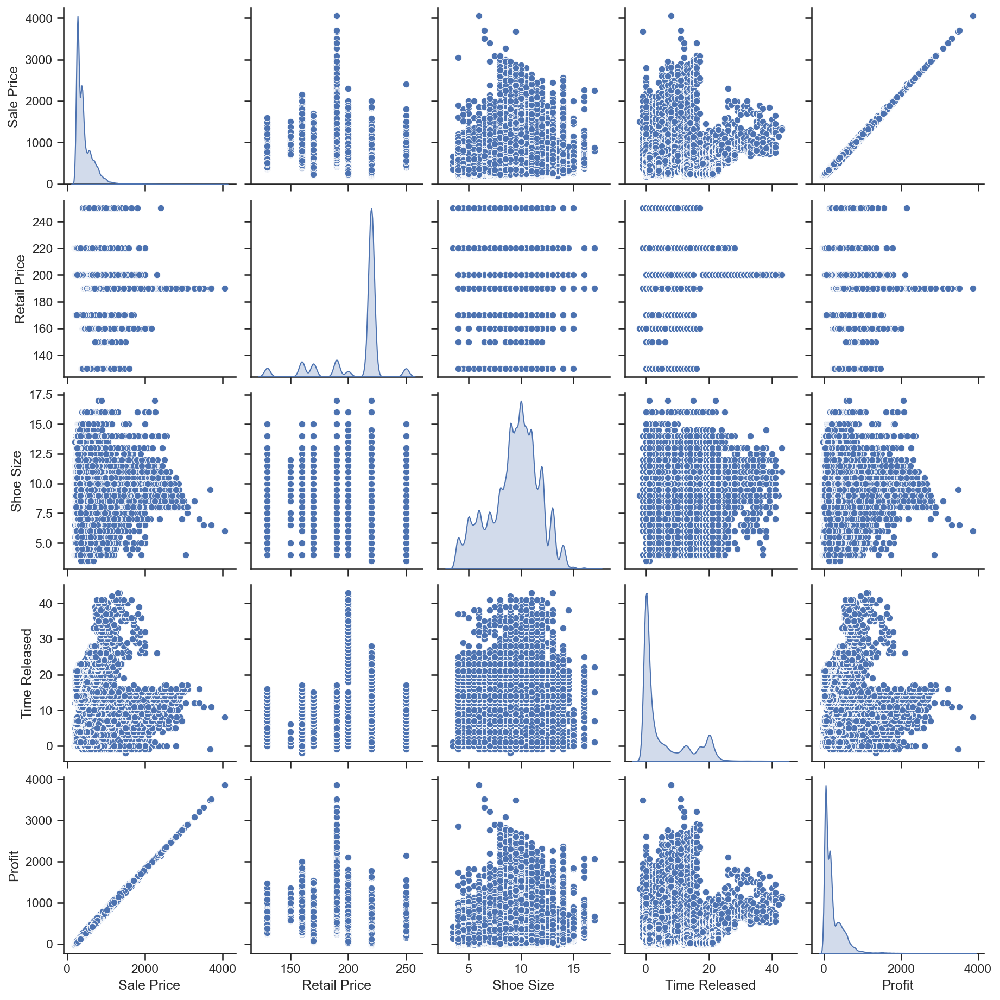

In [53]:
#All variables
sns.pairplot(df,diag_kind='kde')

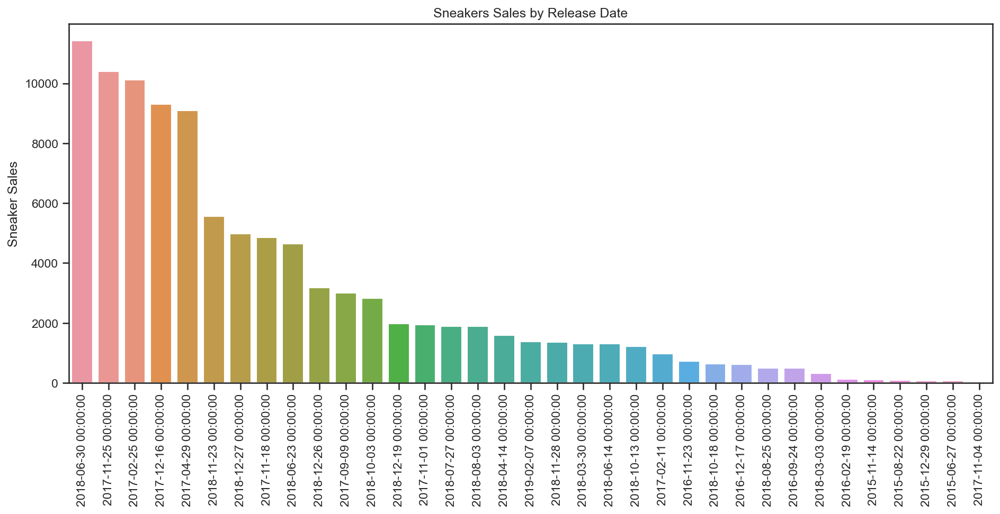

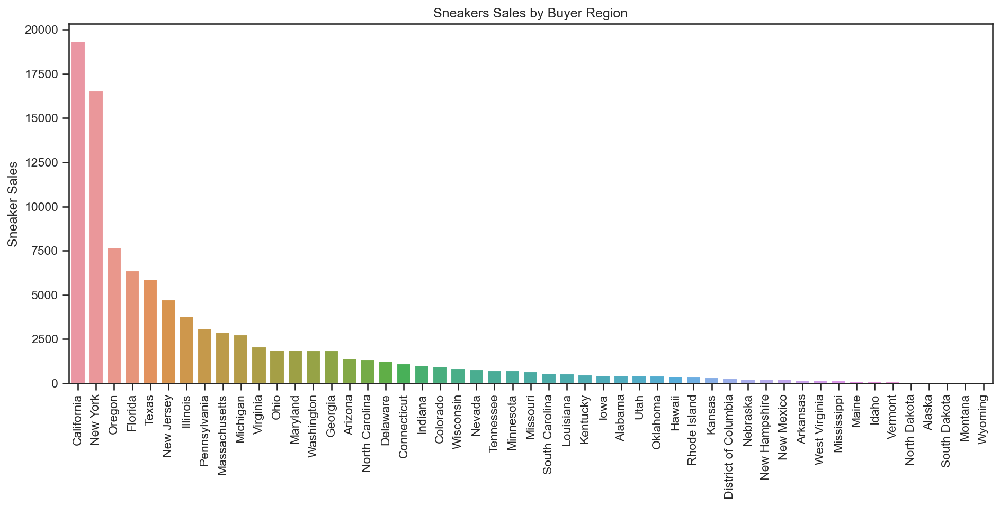

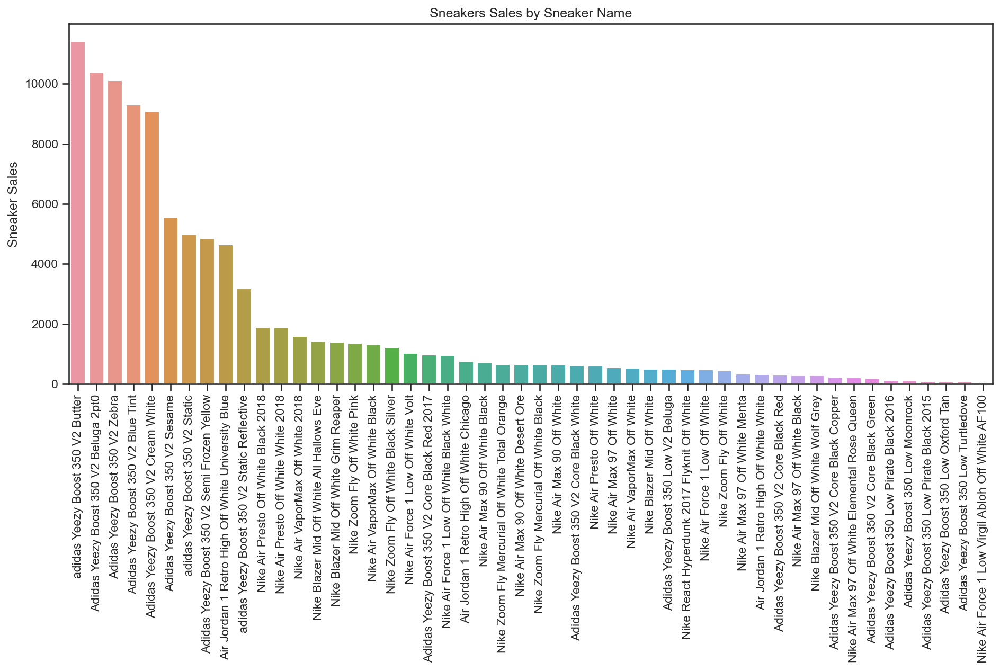

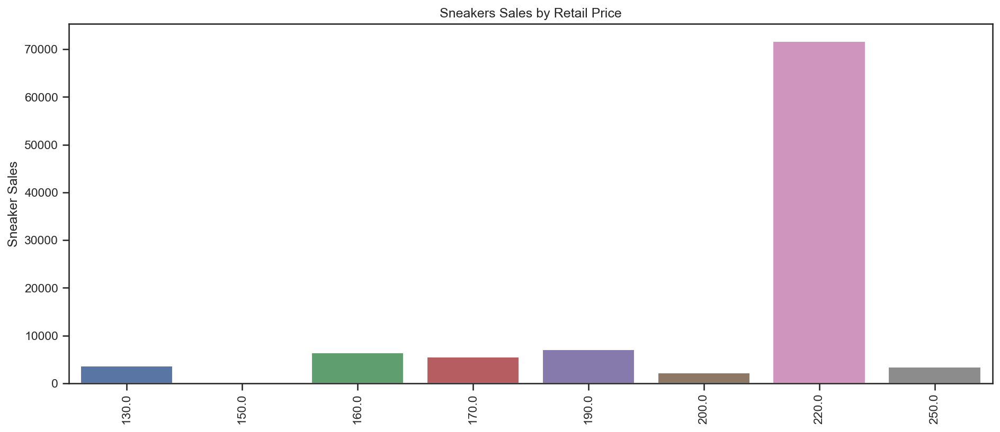

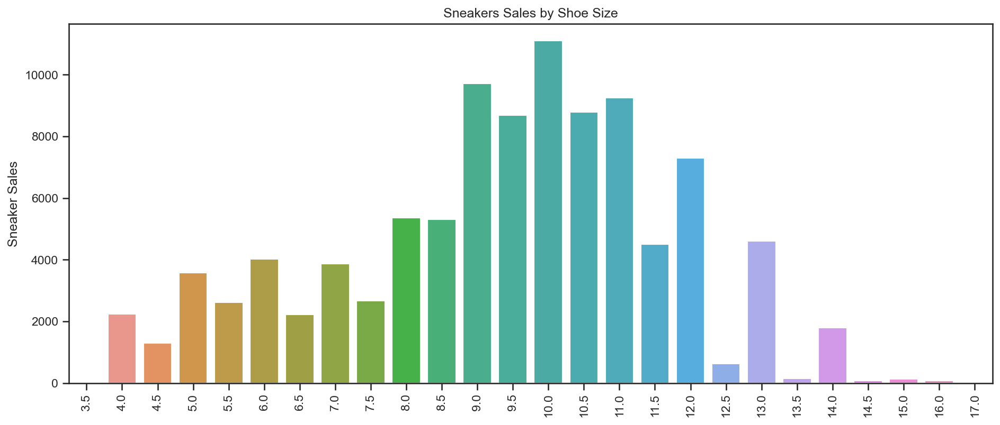

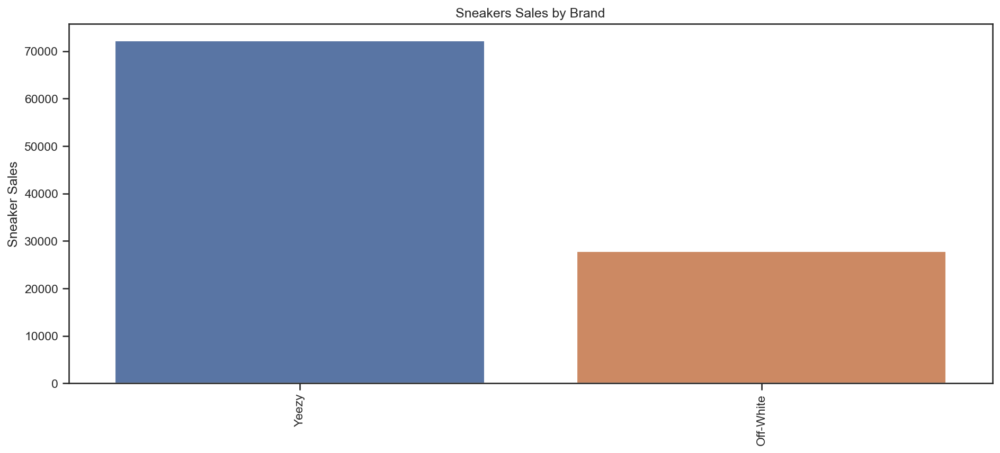

In [54]:
# A combine visualizations on all variables in the Dataframe
df_mix = ['Release Date', 'Buyer Region', 'Sneaker Name', 'Retail Price', 'Shoe Size', 'Brand' ]
for mix in df_mix:
    mix_num = df[str(mix)].value_counts()
    plt.figure(figsize=(15,6))
    chart = sns.barplot(x = mix_num.index, y= mix_num)
    chart.set_title("Sneakers Sales by %s" % (mix))
    plt.ylabel("Sneaker Sales")
    chart.set_xticklabels(chart.get_xticklabels(), rotation = 90)
    plt.gca().xaxis.set_major_locator(plt.MultipleLocator(1))
    plt.show(15)

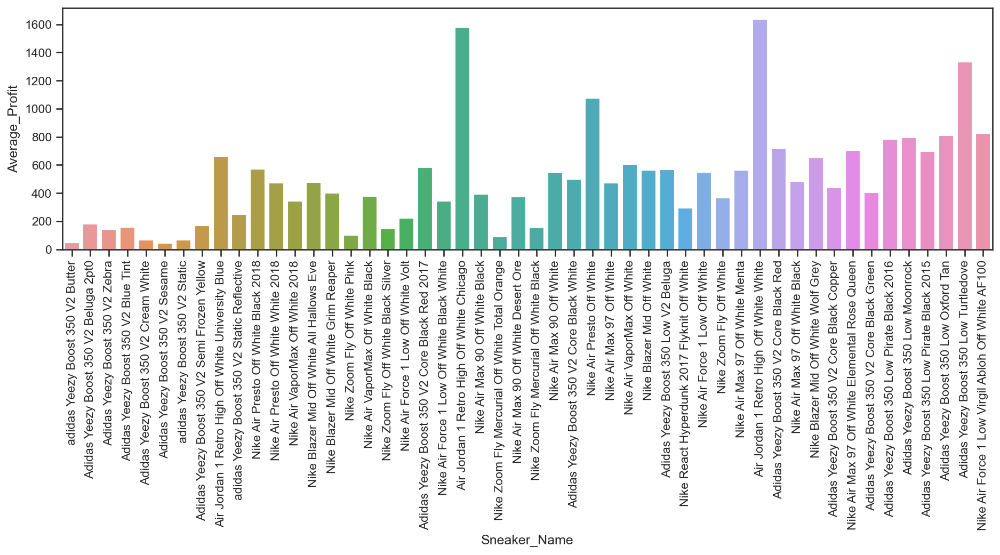

In [55]:
# Analyze trend between Sneaker Name & Sale price
# Create average retail price df
snkr = df[['Sneaker Name', 'Profit']]

# Clean up this list
sneakernames = ['adidas Yeezy Boost 350 V2 Butter',
       'Adidas Yeezy Boost 350 V2 Beluga 2pt0',
       'Adidas Yeezy Boost 350 V2 Zebra',
       'Adidas Yeezy Boost 350 V2 Blue Tint',
       'Adidas Yeezy Boost 350 V2 Cream White',
       'Adidas Yeezy Boost 350 V2 Sesame', 'adidas Yeezy Boost 350 V2 Static',
       'Adidas Yeezy Boost 350 V2 Semi Frozen Yellow',
       'Air Jordan 1 Retro High Off White University Blue',
       'adidas Yeezy Boost 350 V2 Static Reflective',
       'Nike Air Presto Off White Black 2018',
       'Nike Air Presto Off White White 2018',
       'Nike Air VaporMax Off White 2018',
       'Nike Blazer Mid Off White All Hallows Eve',
       'Nike Blazer Mid Off White Grim Reaper', 'Nike Zoom Fly Off White Pink',
       'Nike Air VaporMax Off White Black',
       'Nike Zoom Fly Off White Black Silver',
       'Nike Air Force 1 Low Off White Volt',
       'Adidas Yeezy Boost 350 V2 Core Black Red 2017',
       'Nike Air Force 1 Low Off White Black White',
       'Air Jordan 1 Retro High Off White Chicago',
       'Nike Air Max 90 Off White Black',
       'Nike Zoom Fly Mercurial Off White Total Orange',
       'Nike Air Max 90 Off White Desert Ore',
       'Nike Zoom Fly Mercurial Off White Black', 'Nike Air Max 90 Off White',
       'Adidas Yeezy Boost 350 V2 Core Black White',
       'Nike Air Presto Off White', 'Nike Air Max 97 Off White',
       'Nike Air VaporMax Off White', 'Nike Blazer Mid Off White',
       'Adidas Yeezy Boost 350 Low V2 Beluga',
       'Nike React Hyperdunk 2017 Flyknit Off White',
       'Nike Air Force 1 Low Off White', 'Nike Zoom Fly Off White',
       'Nike Air Max 97 Off White Menta',
       'Air Jordan 1 Retro High Off White White',
       'Adidas Yeezy Boost 350 V2 Core Black Red',
       'Nike Air Max 97 Off White Black',
       'Nike Blazer Mid Off White Wolf Grey',
       'Adidas Yeezy Boost 350 V2 Core Black Copper',
       'Nike Air Max 97 Off White Elemental Rose Queen',
       'Adidas Yeezy Boost 350 V2 Core Black Green',
       'Adidas Yeezy Boost 350 Low Pirate Black 2016',
       'Adidas Yeezy Boost 350 Low Moonrock',
       'Adidas Yeezy Boost 350 Low Pirate Black 2015',
       'Adidas Yeezy Boost 350 Low Oxford Tan',
       'Adidas Yeezy Boost 350 Low Turtledove',
       'Nike Air Force 1 Low Virgil Abloh Off White AF100'
        ]

avgs = []
for name in sneakernames:
    shoerow = snkr.loc[snkr['Sneaker Name'] == name]
    avgs.append(shoerow.mean()[0])
AvgPrice = pd.Series(avgs)
SneakerName = pd.Series(sneakernames)
avgprice_df = pd.DataFrame(columns = ['Sneaker_Name', 'Average_Profit'])
avgprice_df['Sneaker_Name'] = SneakerName
avgprice_df['Average_Profit'] = AvgPrice

# Creating visual of average shoe price
fig_dims = (15, 4)
fig, ax = plt.subplots(figsize=fig_dims)
chart = sns.barplot(x = avgprice_df['Sneaker_Name'] , y= avgprice_df['Average_Profit'])
chart.set_xticklabels(chart.get_xticklabels(), rotation = 90)
plt.gca().xaxis.set_major_locator(plt.MultipleLocator(1))

In [56]:
# Find average sale price by brand
avgs_2 = []
bds = df[['Brand', 'Sale Price']]
brands = [' Yeezy', 'Off-White']
for brand in brands:
    brandrow = bds.loc[bds['Brand'] == str(brand)]
    avgs_2.append(brandrow['Sale Price'].mean())
print('Yeezy average price: $' + str(avgs_2[0]))
print('Off-White average price: $' + str(avgs_2[1]))

Yeezy average price: $360.03255175854326
Off-White average price: $671.4812909260992


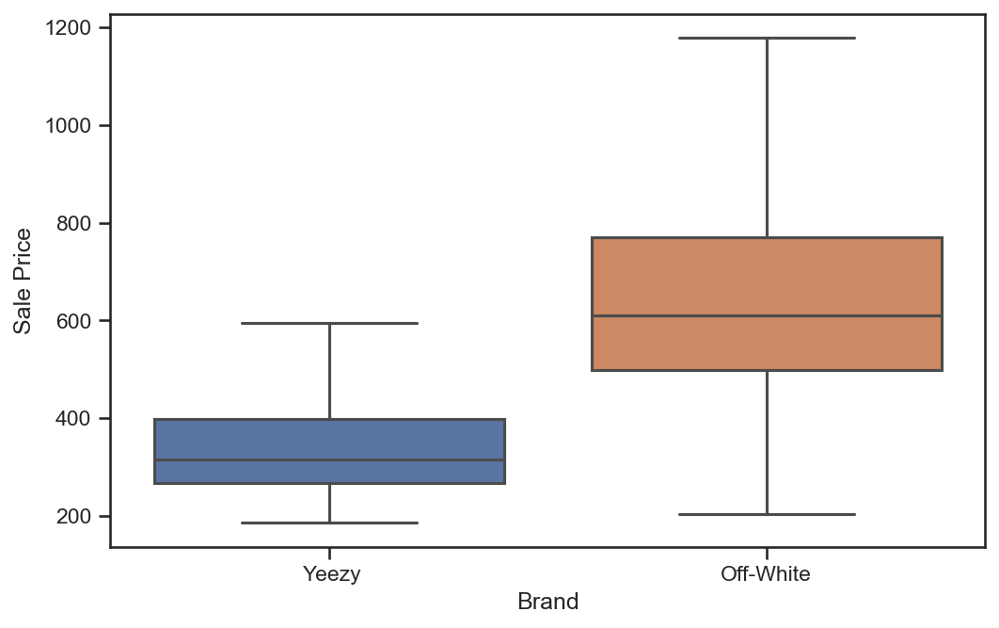

In [57]:
# Create boxplot distribution of sales price by brand
sns.boxplot(x='Brand', y='Sale Price', showfliers = False, data=df)
plt.show()

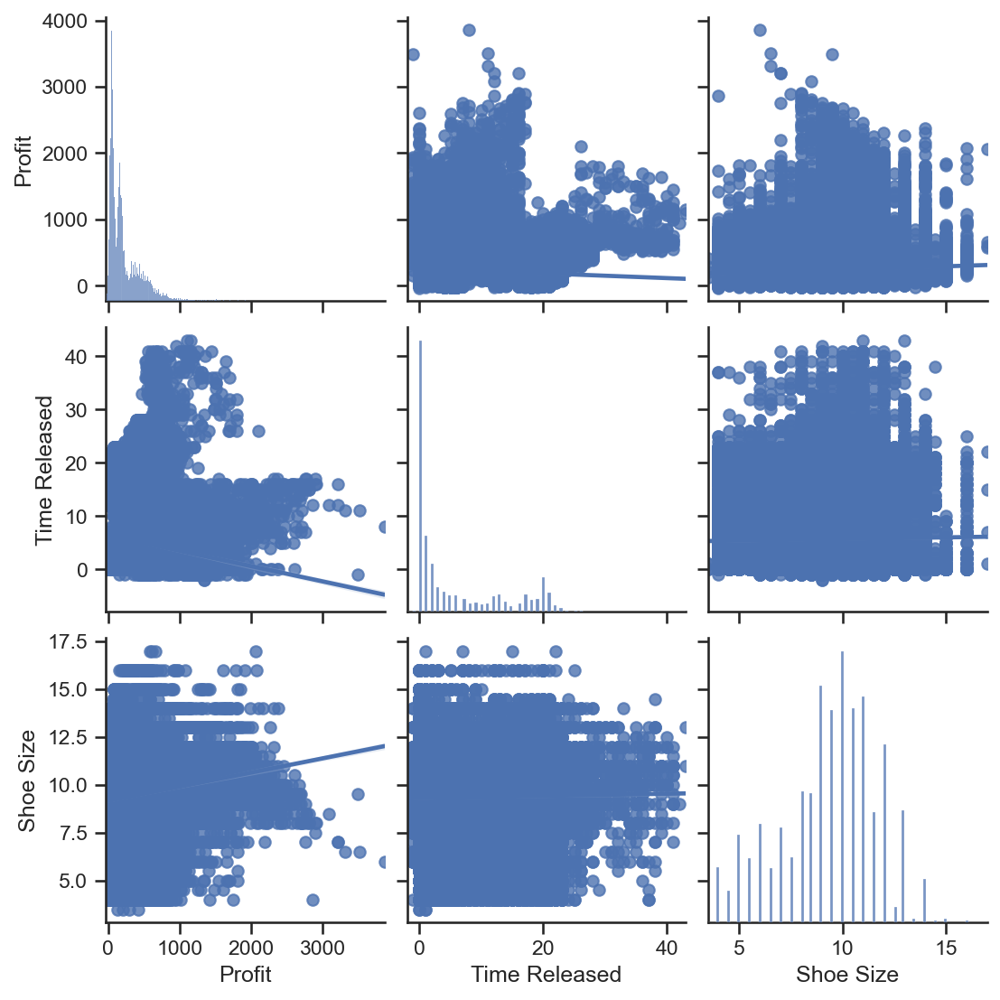

In [58]:
# Plot on Profit, Time Released and Shoe Size
sns.set(style='ticks', color_codes=True)
sns.pairplot(df, vars=['Profit', 'Time Released', 'Shoe Size'], kind='reg')
plt.show()

In [59]:
# Analyze trend between Sales Price and Order Date
# Find average sale price per day
dts = df[['Order Date', 'Sale Price']]
uniq_ord_dates = df['Order Date'].value_counts().index.tolist()
avg_3 = []

for date in uniq_ord_dates:
    daterow = dts.loc[dts['Order Date'] == str(date)]
    avg_3.append(daterow['Sale Price'].mean())

unq_dates = pd.Series(uniq_ord_dates)
date_avgs = pd.Series(avg_3)
dateprice_df = pd.DataFrame(columns = ['Order_date', 'Average_Price'])
dateprice_df['Order_date'] = unq_dates.sort_values(ascending = True)
dateprice_df['Average_Price'] = date_avgs
dateprice_df.head()

,Order_date,Average_Price
482,2017-09-01,653.000000
514,2017-09-02,649.600000
505,2017-09-03,672.437500
501,2017-09-04,623.764706
486,2017-09-05,648.772727


Text(0.5, 1.0, 'Average Daily Sale Price Over time')

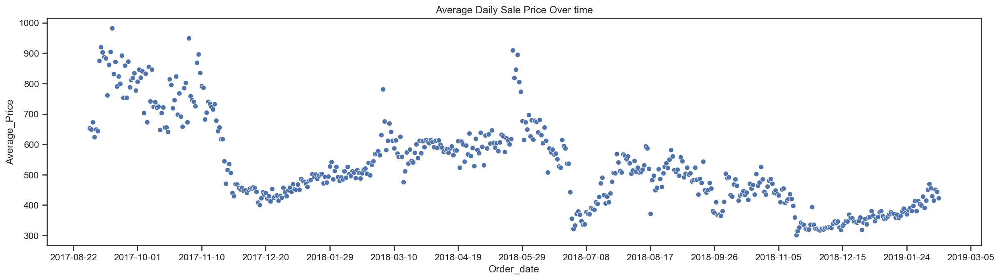

In [60]:
# Create visualization of Average Sale Price Over time
fig_dims = (20, 5)
fig, ax = plt.subplots(figsize=fig_dims)
chart = sns.scatterplot(x="Order_date", y="Average_Price", data=dateprice_df)
plt.gca().xaxis.set_major_locator(plt.MultipleLocator(40))
chart.set_title("Average Daily Sale Price Over time")

In [61]:
# Finding Average Sale Price on Release Dates Over Time
dts = df[['Release Date', 'Sale Price']]
uniq_rel_dates = df['Release Date'].value_counts().index.tolist()
avg_4 = []

for date in uniq_rel_dates:
    daterow = dts.loc[dts['Release Date'] == str(date)]
    avg_4.append(daterow['Sale Price'].mean())

unq_dates = pd.Series(uniq_rel_dates)
date_avgs = pd.Series(avg_4)
dateprice_df_2 = pd.DataFrame(columns = ['Release_date', 'Average_Price'])
dateprice_df_2['Release_date'] = unq_dates.sort_values(ascending = True)
dateprice_df_2['Average_Price'] = date_avgs
dateprice_df_2.head()

,Release_date,Average_Price
33,2015-06-27,1531.661765
31,2015-08-22,895.094737
30,2015-11-14,996.710000
32,2015-12-29,1011.514286
29,2016-02-19,984.237705


Text(0.5, 1.0, 'Average Sale Price by Buyer Region')

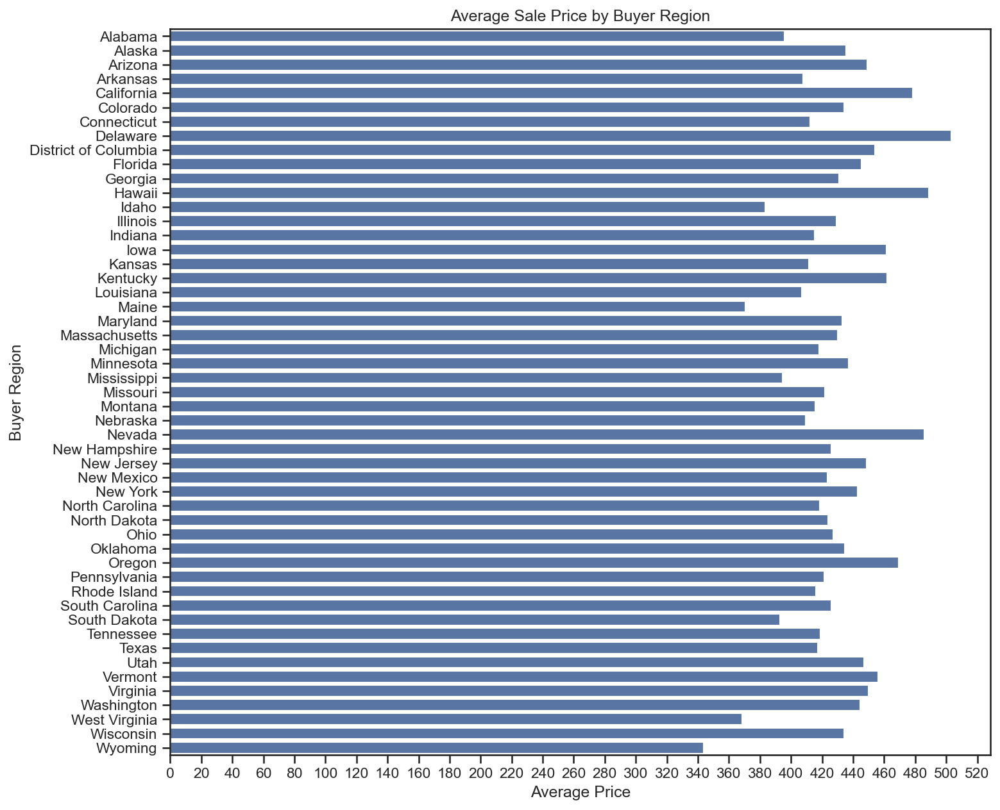

In [62]:
# Analyze trend between buyer region and sale price

brg = df[['Buyer Region', 'Sale Price']]
unq_brgs = df['Buyer Region'].value_counts().index.tolist()
avg_5 = []

for region in unq_brgs:
    regionrow = brg.loc[brg['Buyer Region'] == str(region)]
    avg_5.append(regionrow['Sale Price'].mean())

unq_regions = pd.Series(unq_brgs)
region_avgs = pd.Series(avg_5)
regionprice_df = pd.DataFrame(columns = ['Buyer Region', 'Average Price'])
regionprice_df['Buyer Region'] = unq_regions.sort_values(ascending = True)
regionprice_df['Average Price'] = region_avgs

fig_dims = (11, 10)
fig, ax = plt.subplots(figsize=fig_dims)
chart = sns.barplot(x="Average Price", y="Buyer Region", data=regionprice_df, color="b")
plt.gca().xaxis.set_major_locator(plt.MultipleLocator(20))
chart.set_title("Average Sale Price by Buyer Region")

In [63]:
# Analyze trend between Average Profit and Order Date
dts = df[['Order Date', 'Profit']]
uniq_ord_dates = df['Order Date'].value_counts().index.tolist()
avg_3 = []

for date in uniq_ord_dates:
    daterow = dts.loc[dts['Order Date'] == str(date)]
    avg_3.append(daterow['Profit'].mean())

unq_dates = pd.Series(uniq_ord_dates)
date_avgs = pd.Series(avg_3)
dateprice_df = pd.DataFrame(columns = ['Order_date', 'Average_Profit'])
dateprice_df['Order_date'] = unq_dates.sort_values(ascending = True)
dateprice_df['Average_Profit'] = date_avgs
dateprice_df.head()


,Order_date,Average_Profit
482,2017-09-01,433.000000
514,2017-09-02,429.600000
505,2017-09-03,452.437500
501,2017-09-04,403.764706
486,2017-09-05,428.772727


Text(0.5, 1.0, 'Average Daily Profit Over time')

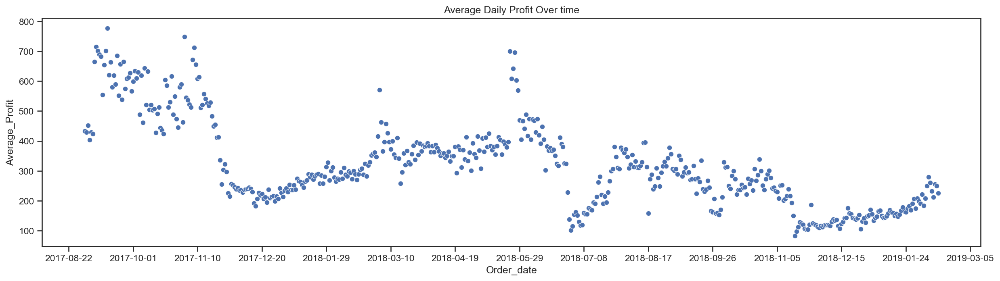

In [64]:
# Create visualization of Average Profit Over time
fig_dims = (20, 5)
fig, ax = plt.subplots(figsize=fig_dims)
chart = sns.scatterplot(x="Order_date", y="Average_Profit", data=dateprice_df)
plt.gca().xaxis.set_major_locator(plt.MultipleLocator(40))
chart.set_title("Average Daily Profit Over time")

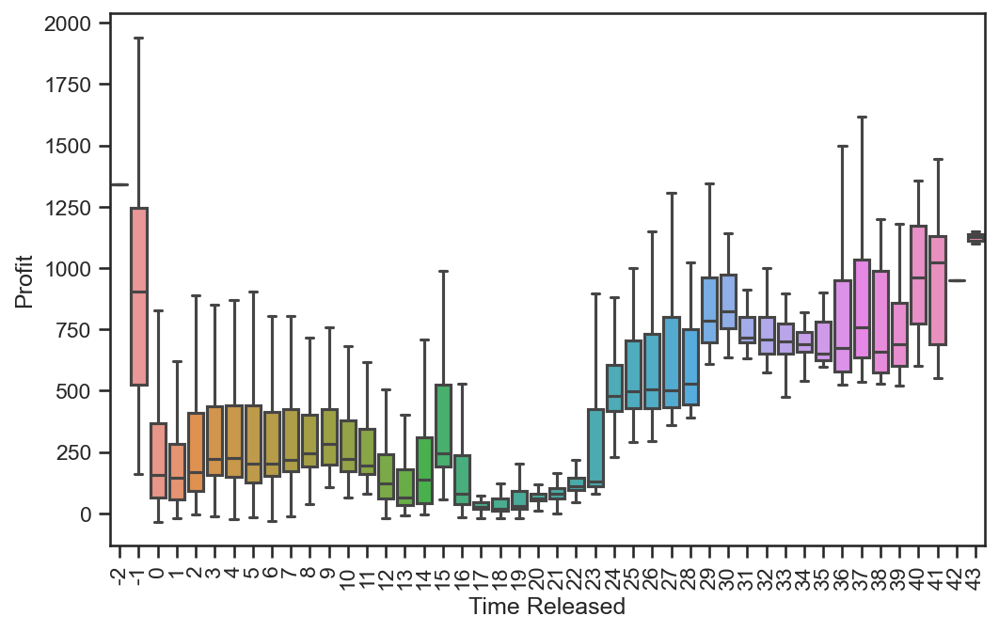

In [65]:
# Create boxplot on Time Released and Profit 
ax = sns.boxplot(data=df, x='Time Released', y='Profit', showfliers = False)
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
plt.show()

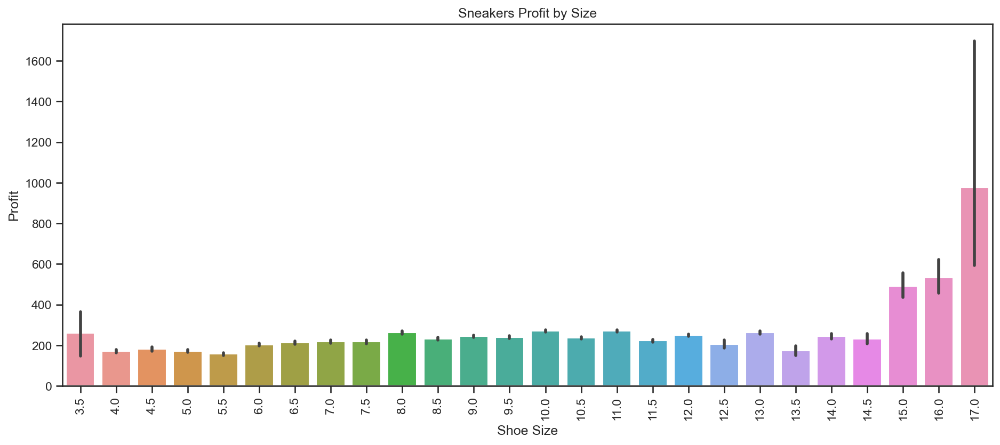

In [66]:
# Create barchart on Size and Profit 
plt.figure(figsize=(15,6))
chart1=sns.barplot(x = 'Shoe Size', y= 'Profit', data = df)
chart1.set_title("Sneakers Profit by Size" )
plt.ylabel("Profit")
chart1.set_xticklabels(chart1.get_xticklabels(), rotation = 90)
plt.gca().xaxis.set_major_locator(plt.MultipleLocator(1))
plt.show(15)

In [85]:
# Create a more complex graph on Time Released, Profit and brand along with other variables.

import altair as alt

alt.data_transformers.disable_max_rows()

source = df

alt.Chart(df).mark_circle(size=60).encode(
    x='Time Released',
    y='Profit',
    color='Brand',
    tooltip=['Brand','Profit','Shoe Size',
             'Time Released']).interactive()

alt.Chart(...)

# Building Model

In [68]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import preprocessing

# Model #1

In [69]:
# Create features and target variables

features = ['Sneaker Name', 'Time Released']
target = 'Sale Price'

X = df[features]
y = df[target]

In [70]:
# Get dummies varibles

X = pd.get_dummies(X)

In [71]:
# Split to training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.3, random_state = 42)

In [72]:
sc = preprocessing.StandardScaler()

X_train_std = sc.fit_transform(X_train)
X_test_std = sc.transform (X_test)

In [73]:
# Linear Regression
regressor = LinearRegression()

regressor.fit(X_train_std, y_train)

LinearRegression()

In [74]:
# Regression score
regressor.score(X_test_std, y_test)

0.835028465739472

In [75]:
# Actual and Predict price

y_pred = regressor.predict(X_test_std)

evaluate = pd.DataFrame({'Actual': y_test.values.flatten(), 'Predicted': y_pred.flatten()})
evaluate.head(10)

,Actual,Predicted
0,264.0,279.429448
1,585.0,455.501713
2,365.0,331.214604
3,887.0,858.958745
4,850.0,732.363041
5,360.0,421.495854
6,898.0,858.958745
7,260.0,273.124760
8,680.0,552.544682
9,640.0,688.448979


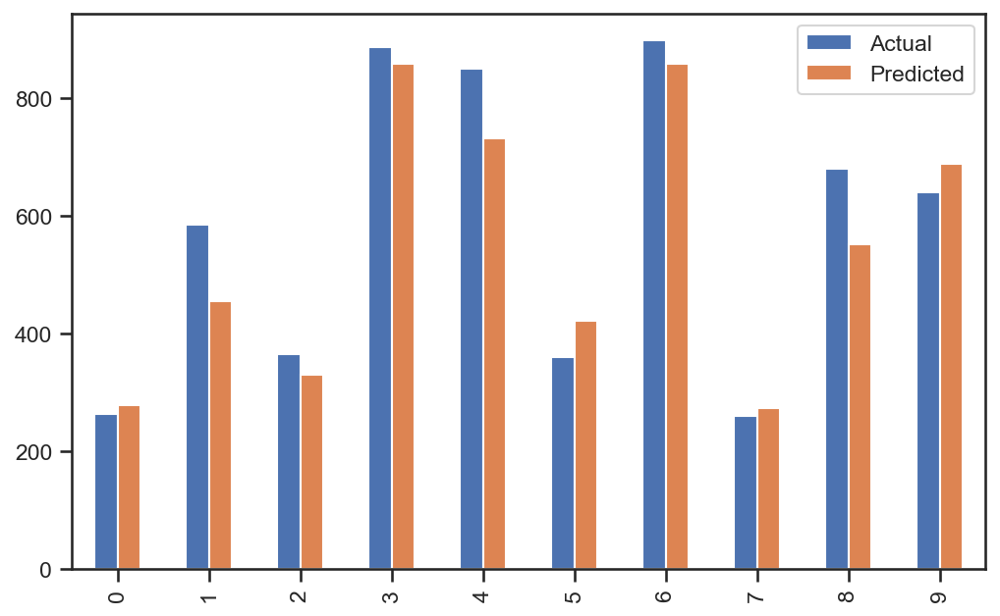

In [76]:
# Plot the data
evaluate.head(10).plot(kind = 'bar')
plt.show()

# Model #2

In [77]:
# Create features and target variables

features = ['Sneaker Name', 'Time Released', 'Shoe Size']
target = 'Sale Price'

X = df[features]
y = df[target]

In [78]:
# Get dummies varibles
X = pd.get_dummies(X, columns=['Sneaker Name', 'Shoe Size'])

In [79]:
X.head()

,Time Released,Sneaker Name_Adidas Yeezy Boost 350 Low Moonrock,Sneaker Name_Adidas Yeezy Boost 350 Low Oxford Tan,Sneaker Name_Adidas Yeezy Boost 350 Low Pirate Black 2015,Sneaker Name_Adidas Yeezy Boost 350 Low Pirate Black 2016,Sneaker Name_Adidas Yeezy Boost 350 Low Turtledove,Sneaker Name_Adidas Yeezy Boost 350 Low V2 Beluga,Sneaker Name_Adidas Yeezy Boost 350 V2 Beluga 2pt0,Sneaker Name_Adidas Yeezy Boost 350 V2 Blue Tint,Sneaker Name_Adidas Yeezy Boost 350 V2 Core Black Copper,Sneaker Name_Adidas Yeezy Boost 350 V2 Core Black Green,Sneaker Name_Adidas Yeezy Boost 350 V2 Core Black Red,Sneaker Name_Adidas Yeezy Boost 350 V2 Core Black Red 2017,Sneaker Name_Adidas Yeezy Boost 350 V2 Core Black White,Sneaker Name_Adidas Yeezy Boost 350 V2 Cream White,Sneaker Name_Adidas Yeezy Boost 350 V2 Semi Frozen Yellow,Sneaker Name_Adidas Yeezy Boost 350 V2 Sesame,Sneaker Name_Adidas Yeezy Boost 350 V2 Zebra,Sneaker Name_Air Jordan 1 Retro High Off White Chicago,Sneaker Name_Air Jordan 1 Retro High Off White University Blue,Sneaker Name_Air Jordan 1 Retro High Off White White,Sneaker Name_Nike Air Force 1 Low Off White,Sneaker Name_Nike Air Force 1 Low Off White Black White,Sneaker Name_Nike Air Force 1 Low Off White Volt,Sneaker Name_Nike Air Force 1 Low Virgil Abloh Off White AF100,Sneaker Name_Nike Air Max 90 Off White,Sneaker Name_Nike Air Max 90 Off White Black,Sneaker Name_Nike Air Max 90 Off White Desert Ore,Sneaker Name_Nike Air Max 97 Off White,Sneaker Name_Nike Air Max 97 Off White Black,Sneaker Name_Nike Air Max 97 Off White Elemental Rose Queen,Sneaker Name_Nike Air Max 97 Off White Menta,Sneaker Name_Nike Air Presto Off White,Sneaker Name_Nike Air Presto Off White Black 2018,Sneaker Name_Nike Air Presto Off White White 2018,Sneaker Name_Nike Air VaporMax Off White,Sneaker Name_Nike Air VaporMax Off White 2018,Sneaker Name_Nike Air VaporMax Off White Black,Sneaker Name_Nike Blazer Mid Off White,Sneaker Name_Nike Blazer Mid Off White All Hallows Eve,Sneaker Name_Nike Blazer Mid Off White Grim Reaper,Sneaker Name_Nike Blazer Mid Off White Wolf Grey,Sneaker Name_Nike React Hyperdunk 2017 Flyknit Off White,Sneaker Name_Nike Zoom Fly Mercurial Off White Black,Sneaker Name_Nike Zoom Fly Mercurial Off White Total Orange,Sneaker Name_Nike Zoom Fly Off White,Sneaker Name_Nike Zoom Fly Off White Black Silver,Sneaker Name_Nike Zoom Fly Off White Pink,Sneaker Name_adidas Yeezy Boost 350 V2 Butter,Sneaker Name_adidas Yeezy Boost 350 V2 Static,Sneaker Name_adidas Yeezy Boost 350 V2 Static Reflective,Shoe Size_3.5,Shoe Size_4.0,Shoe Size_4.5,Shoe Size_5.0,Shoe Size_5.5,Shoe Size_6.0,Shoe Size_6.5,Shoe Size_7.0,Shoe Size_7.5,Shoe Size_8.0,Shoe Size_8.5,Shoe Size_9.0,Shoe Size_9.5,Shoe Size_10.0,Shoe Size_10.5,Shoe Size_11.0,Shoe Size_11.5,Shoe Size_12.0,Shoe Size_12.5,Shoe Size_13.0,Shoe Size_13.5,Shoe Size_14.0,Shoe Size_14.5,Shoe Size_15.0,Shoe Size_16.0,Shoe Size_17.0
0,11,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1,9,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
2,9,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
3,9,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
4,6,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [80]:
# Split to training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.3, random_state = 42)

sc = preprocessing.StandardScaler()

X_train_std = sc.fit_transform(X_train)
X_test_std = sc.transform (X_test)

regressor = LinearRegression()

regressor.fit(X_train_std, y_train)

LinearRegression()

In [81]:
# Linear regression score 
regressor.score(X_test_std, y_test)

0.8375475232932333

In [82]:
# Actual vs. Predicted
y_pred = regressor.predict(X_test_std)

evaluate = pd.DataFrame({'Actual': y_test.values.flatten(), 'Predicted': y_pred.flatten()})
evaluate.head(10)

,Actual,Predicted
0,264.0,280.704830
1,585.0,458.604976
2,365.0,331.829830
3,887.0,856.478268
4,850.0,735.267330
5,360.0,416.954830
6,898.0,856.329830
7,260.0,271.767330
8,680.0,561.454830
9,640.0,685.767330


<AxesSubplot:>

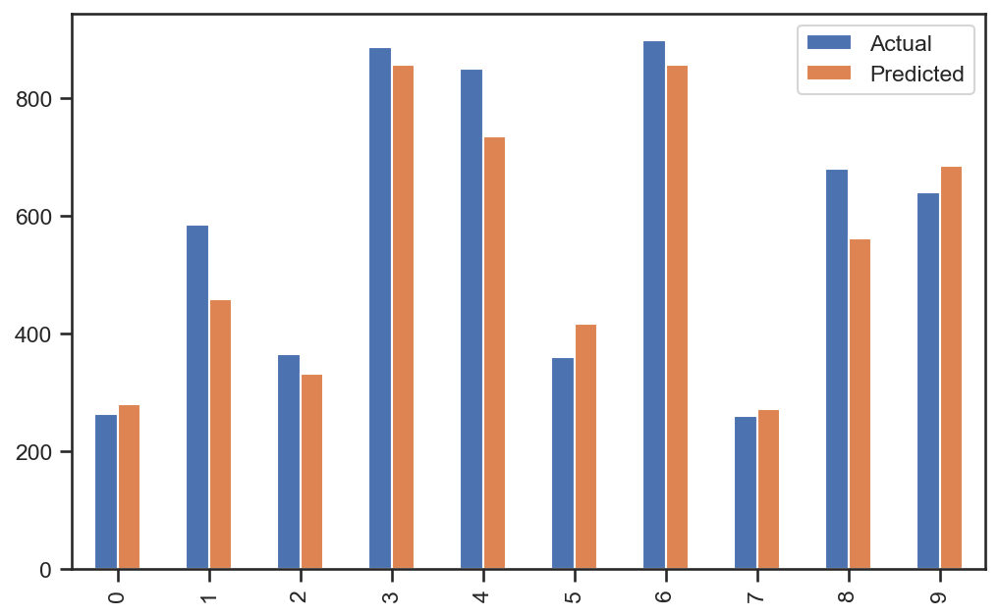

In [83]:
evaluate.head(10).plot(kind = 'bar')

In [84]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
# R2 Score
print(f"R2 score: {r2_score(y_test, y_pred)}")
# Mean Absolute Error (MAE)
print(f"MAE score: {mean_absolute_error(y_test, y_pred)}")
# Mean Squared Error (MSE)
print(f"MSE score: {mean_squared_error(y_test, y_pred)}")

R2 score: 0.8375475232932333
MAE score: 60.80325658870375
MSE score: 10749.412908565157


# Conclusion


Off-white sneakers are selling for more than Yeezy, which due to lower stock and more diverse collections. Man shoe woman size (3.5-7) are generally selling for more. On the other end, the biggest size (>=15) is selling for way more than the regulars. However, these companies only release on the market till size 15. Prior to the release date, the sneaker price is the highest since only a few people could get it. After the release date, the price stays steady until around the 10th date. Then the price drops until around the 20th month of the release and then goes up again. Price stays steady around the 30th month, and the price decides by the individual buyer at that point. 

The linear regression model shows that the three most important factors as predicted are size, time-released, and sneaker name, which link to the item's hype level.  Both Model 1 and Model 2 showed promising R^2 scores. However, speaking from experience, sneakers prices are ultra unpredictable. The law of supply and demand applies to the sneaker market, in which individual buyer has a significant influence on the price on a specific date (highest bid and lowest ask). Other undetermined variables that are not in the model could also directly affect the price (i.e., item restock, demand surge); therefore, The model is for reference only. It is not an accurate reflection of the market price. 